In [1]:
%matplotlib inline

this is only here as the package is not install yet.

In [2]:
cd ..

/Users/au194693/projects/sim_data


In [3]:
import sim_data as sd
import numpy as np
import mne
from mne.datasets import spm_face, somato, eegbci
from mne.datasets.brainstorm import bst_raw

# Pipeline

For each of the sample datasets the following is done:

* loading data.
* epoching.
* search for the best order of the polynomial.
* simulate data based on the epochs and best order number.
* plot:
    - "joint" plots of the real data and the simluted data.
    - The difference between the real and simulated data.
    - psd of the real data and the simluted data.

# Preprocessing spm_face

In [4]:
data_path = spm_face.data_path()
raw_fname = data_path + '/MEG/spm/SPM_CTF_MEG_example_faces%d_3D.ds'

spm_raw = mne.io.read_raw_ctf(raw_fname % 1, preload=True)  # Take first run
# Here to save memory and time we'll downsample heavily -- this is not
# advised for real data as it can effectively jitter events!
spm_raw.resample(120., npad='auto')

picks = mne.pick_types(spm_raw.info, meg="mag", exclude='bads')
spm_raw.filter(1, 30, method='iir')

events = mne.find_events(spm_raw, stim_channel='UPPT001')
event_ids = {"faces": 1, "scrambled": 2}

tmin, tmax = -0.2, 0.6
baseline = None  # no baseline as high-pass is applied
reject = dict(mag=5e-12)

spm_epo = mne.Epochs(spm_raw, events, event_ids, tmin, tmax,  picks=picks,
                    baseline=baseline, preload=True, reject=reject)

ds directory : /Users/au194693/mne_data/MNE-spm-face/MEG/spm/SPM_CTF_MEG_example_faces1_3D.ds
    res4 data read.
    hc data read.
    Separate EEG position data file not present.
    Quaternion matching (desired vs. transformed):
      -0.90   72.01    0.00 mm <->   -0.90   72.01    0.00 mm (orig :  -43.09   61.46 -252.17 mm) diff =    0.000 mm
       0.90  -72.01    0.00 mm <->    0.90  -72.01    0.00 mm (orig :   53.49  -45.24 -258.02 mm) diff =    0.000 mm
      98.30    0.00    0.00 mm <->   98.30   -0.00    0.00 mm (orig :   78.60   72.16 -241.87 mm) diff =    0.000 mm
    Coordinate transformations established.
    Polhemus data for 3 HPI coils added
    Device coordinate locations for 3 HPI coils added
    Measurement info composed.
Finding samples for /Users/au194693/mne_data/MNE-spm-face/MEG/spm/SPM_CTF_MEG_example_faces1_3D.ds/SPM_CTF_MEG_example_faces1_3D.meg4: 
    System clock channel is available, checking which samples are valid.
    1 x 324474 = 324474 samples from 34

In [5]:
spm_sim_data = sd.make_sim_data(spm_epo, order=18)

167 matching events found
0 projection items activated
0 bad epochs dropped


Real data


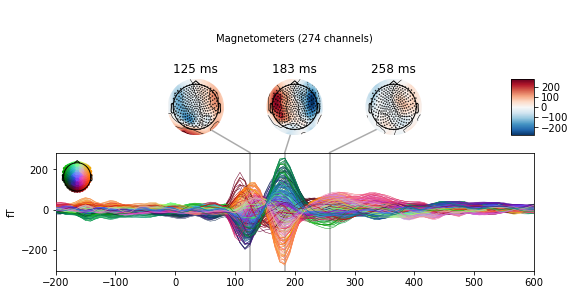

simulated data


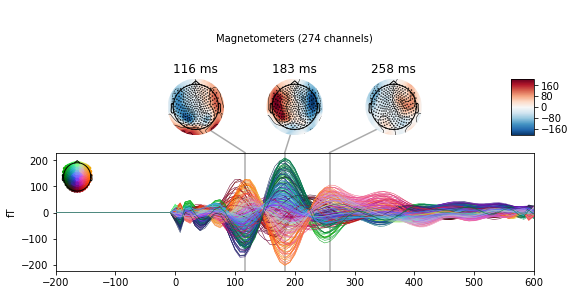

In [6]:
print("Real data")
spm_epo.average().plot_joint();
print("simulated data")
spm_sim_data.average().plot_joint();

the difference of real and simulated data


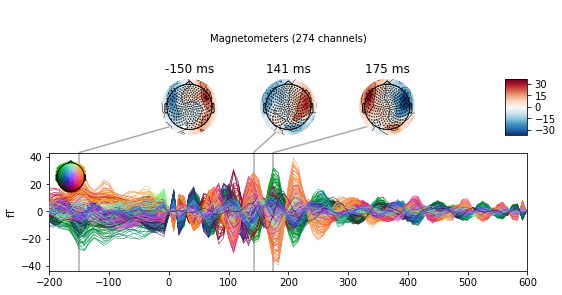

In [7]:
diff = mne.combine_evoked([spm_epo.average(), -spm_sim_data.average()], weights="equal")
print("the difference of real and simulated data")
diff.plot_joint();

# Preprocessing somato dataset

In [8]:
data_path = somato.data_path()
raw_fname = data_path + '/MEG/somato/sef_raw_sss.fif'

# Setup for reading the raw data
somato_raw = mne.io.read_raw_fif(raw_fname)
events = mne.find_events(somato_raw, stim_channel='STI 014')

# picks MEG gradiometers
picks = mne.pick_types(somato_raw.info, meg='grad', eeg=False, eog=True, stim=False)

# Construct Epochs
event_id, tmin, tmax = 1, -1., 3.
baseline = (None, 0)
somato_epo = mne.Epochs(somato_raw, events, event_id, tmin, tmax, picks=picks,
                        baseline=baseline, reject=dict(grad=4000e-13, eog=350e-6),
                        preload=True)

Opening raw data file /Users/au194693/mne_data/MNE-somato-data/MEG/somato/sef_raw_sss.fif...
    Range : 237600 ... 506999 =    791.189 ...  1688.266 secs
Ready.
Current compensation grade : 0
111 events found
Events id: [1]
111 matching events found
0 projection items activated
Loading data for 111 events and 1202 original time points ...
    Rejecting  epoch based on EOG : ['EOG 061']
    Rejecting  epoch based on EOG : ['EOG 061']
    Rejecting  epoch based on EOG : ['EOG 061']
3 bad epochs dropped


Working on order: 5
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 6
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 7
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 8
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 9
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 10
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 11
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 12
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 13
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 14
108 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 15
108 matching e

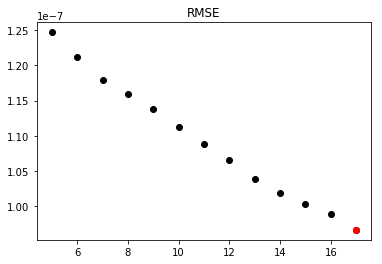

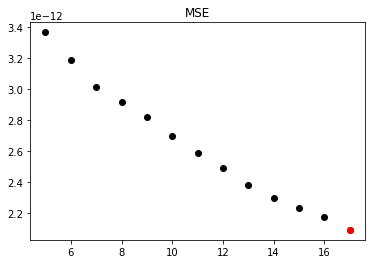

In [9]:
orders = np.arange(5, 18, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(somato_epo,
                                                                          orders=orders, 
                                                                          plot=True)

In [10]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

5


In [11]:
somato_sim_data = sd.make_sim_data(somato_epo, order=17)

108 matching events found
0 projection items activated
0 bad epochs dropped


Real data


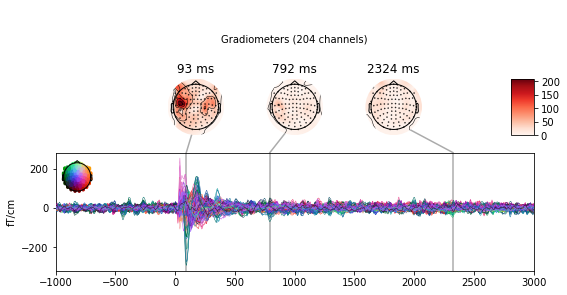

Simulated data


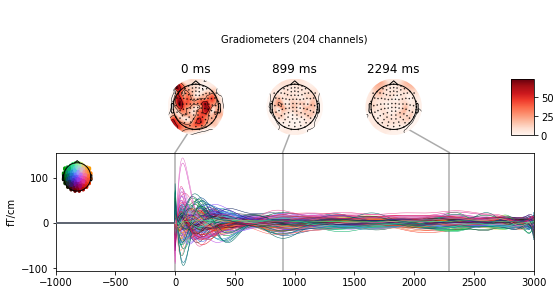

In [12]:
print("Real data")
somato_epo.average().plot_joint();
print("Simulated data")
somato_sim_data.average().plot_joint();

Difference between real and simulated data.


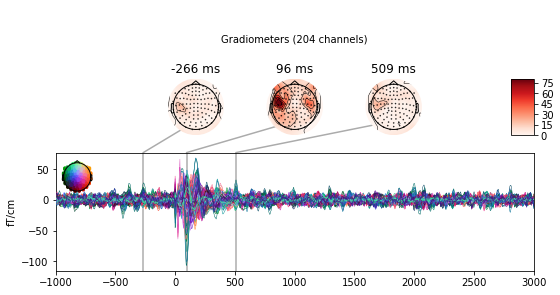

In [13]:
diff = mne.combine_evoked([somato_epo.average(), -somato_sim_data.average()], weights="equal")
print("Difference between real and simulated data.")
diff.plot_joint();

# Preprocessing eegbci dataset

In [14]:
tmin, tmax = -1., 4.
event_id = dict(hands=2, feet=3)
subject = 1
runs = [6, 10, 14]  # motor imagery: hands vs feet

raw_fnames = eegbci.load_data(subject, runs)
raw_files = [mne.io.read_raw_edf(f, preload=True) for f in raw_fnames]
bci_raw = mne.io.concatenate_raws(raw_files)

# strip channel names of "." characters
bci_raw.rename_channels(lambda x: x.strip('.'))

# Apply band-pass filter
bci_raw.filter(7., 30., fir_design='firwin')

events = mne.find_events(bci_raw, shortest_event=0, stim_channel='STI 014')

picks = mne.pick_types(bci_raw.info, meg=False, eeg=True, stim=False, eog=False,
                   exclude='bads')

# Read epochs (train will be done only between 1 and 2s)
# Testing will be done with a running classifier
bci_epo = mne.Epochs(bci_raw, events, event_id, tmin, tmax, proj=True, picks=picks,
                        baseline=None, preload=True)

Extracting edf Parameters from /Users/au194693/mne_data/MNE-eegbci-data/physiobank/database/eegmmidb/S001/S001R06.edf...
EDF file detected
Setting channel info structure...
Created Raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Ready.
Extracting edf Parameters from /Users/au194693/mne_data/MNE-eegbci-data/physiobank/database/eegmmidb/S001/S001R10.edf...
EDF file detected
Setting channel info structure...
Created Raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Ready.
Extracting edf Parameters from /Users/au194693/mne_data/MNE-eegbci-data/physiobank/database/eegmmidb/S001/S001R14.edf...
EDF file detected
Setting channel info structure...
Created Raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Ready.
Setting up band-pass filter from 7 - 30 Hz
l_trans_bandwidth chosen to be 2.0 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 264 samples (1.650 sec) selected
Removing orphaned offset at the b

Working on order: 5
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 6
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 7
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 8
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 9
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 10
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 11
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 12
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 13
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 14
45 matching events found
0 projection items activated
0 bad epochs dropped
Working on order: 15
45 matching events found

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 19


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 20


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 21


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 22


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 23


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 24


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 25


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 26


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

Working on order: 27


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

45 matching events found
0 projection items activated
0 bad epochs dropped


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

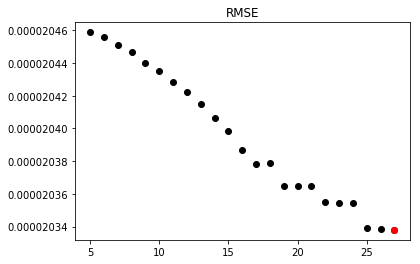

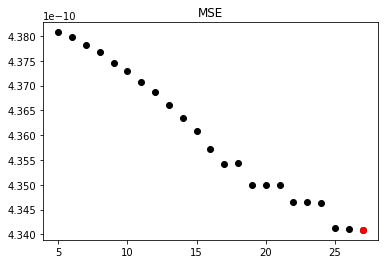

In [15]:
orders = np.arange(5, 28, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(bci_epo,
                                                                          orders=orders, 
                                                                          plot=True)

In [16]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

5


In [17]:
bci_sim_data = sd.make_sim_data(bci_epo, baseline=(None, -0.1), order=17)

45 matching events found
0 projection items activated
0 bad epochs dropped


Real data


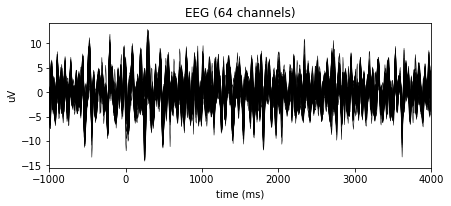

simulated data


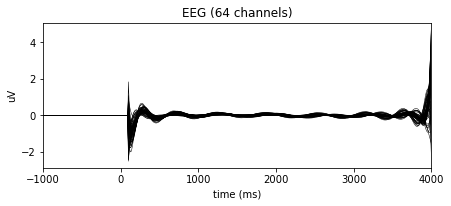

In [18]:
print("Real data")
bci_epo.average().plot();
print("simulated data")
bci_sim_data.average().plot();

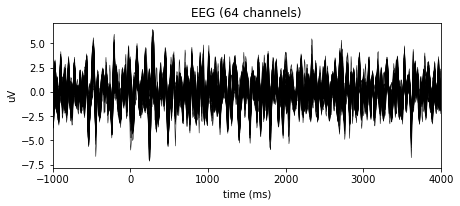

In [19]:
diff = mne.combine_evoked([bci_epo.average(), -bci_sim_data.average()], weights="equal")
diff.plot();

# Preprocessing brainstorm nerve stim dataset

In [20]:
tmin, tmax, event_id = -0.1, 0.3, 2  # take right-hand somato
reject = dict(mag=4e-12, eog=250e-6)

data_path = bst_raw.data_path()

raw_fname = data_path + '/MEG/bst_raw/' + \
                        'subj001_somatosensory_20111109_01_AUX-f_raw.fif'
bst_raw = mne.io.read_raw_fif(raw_fname, preload=True)

# set EOG channel
bst_raw.set_channel_types({'EEG058': 'eog'})
bst_raw.set_eeg_reference()

# show power line interference and remove it
bst_raw.notch_filter(np.arange(60, 181, 60))

events = mne.find_events(bst_raw, stim_channel='UPPT001')

# pick MEG channels
picks = mne.pick_types(bst_raw.info, meg=True, eeg=False, stim=False, eog=True,
                       exclude='bads')

# Compute epochs
bst_epo = mne.Epochs(bst_raw, events, event_id, tmin, tmax, picks=picks,
                     baseline=(None, 0), reject=reject, preload=False)

Opening raw data file /Users/au194693/mne_data/MNE-brainstorm-data/bst_raw/MEG/bst_raw/subj001_somatosensory_20111109_01_AUX-f_raw.fif...
    Read 5 compensation matrices
    Range : 0 ... 431999 =      0.000 ...   359.999 secs
Ready.
Current compensation grade : 3
Reading 0 ... 431999  =      0.000 ...   359.999 secs...
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but hasn't been applied yet. Use the .apply_proj() method function to apply projections.
Setting up band-stop filter
fir_design defaults to "firwin2" in 0.15 but will change to "firwin" in 0.16, set it explicitly to avoid this warning.
Filter length of 15840 samples (13.200 sec) selected


<ipython-input-20-4c398da3d144>:14: DeprecationWarning: fir_design defaults to "firwin2" in 0.15 but will change to "firwin" in 0.16, set it explicitly to avoid this warning.
  bst_raw.notch_filter(np.arange(60, 181, 60))


200 events found
Events id: [1 2]
102 matching events found
1 projection items activated


Working on order: 15
Loading data for 102 events and 481 original time points ...
    Rejecting  epoch based on EOG : ['EEG058']
    Rejecting  epoch based on EOG : ['EEG058']
3 bad epochs dropped
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 16
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 17
99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 18


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 19


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 20


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 21


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

0 bad epochs dropped
Working on order: 22


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

1 projection items activated
0 bad epochs dropped
Working on order: 23


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated
0 bad epochs dropped
Working on order: 24


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

99 matching events found
1 projection items activated


/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be poorly conditioned
  epochs.get_data()[k, j, bs_index:], order))
/Users/au194693/projects/sim_data/sim_data/sim_data.py:58: RankWarning: Polyfit may be p

0 bad epochs dropped


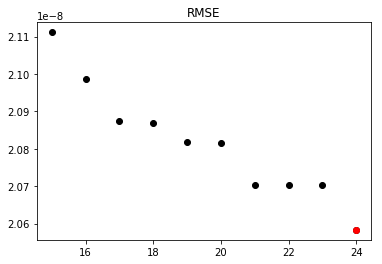

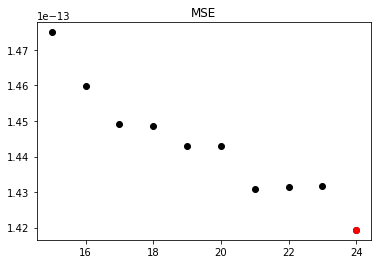

In [21]:
orders = np.arange(15, 25, 1)  # The orders to search
mse_res, rmse_res, r2_res, aic_res, loglik_res = sd.search_for_best_order(bst_epo,
                                                                          orders=orders, 
                                                                          plot=True)

In [22]:
best_order = orders[np.asarray(mse_res).argmin()]
print(best_order)

15


In [23]:
bst_sim_data = sd.make_sim_data(bst_epo, order=17)

99 matching events found
1 projection items activated
0 bad epochs dropped


Real data


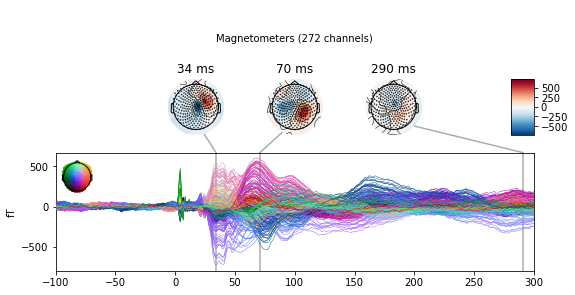

Simulated data


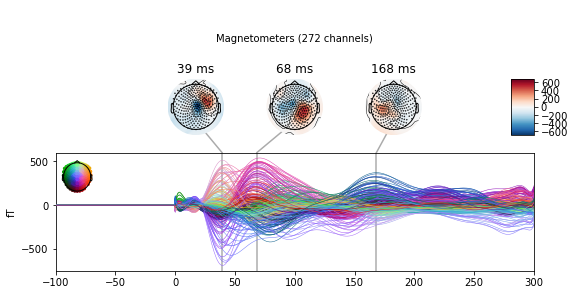

In [24]:
print("Real data")
bst_epo.average().plot_joint();
print("Simulated data")
bst_sim_data.average().plot_joint();

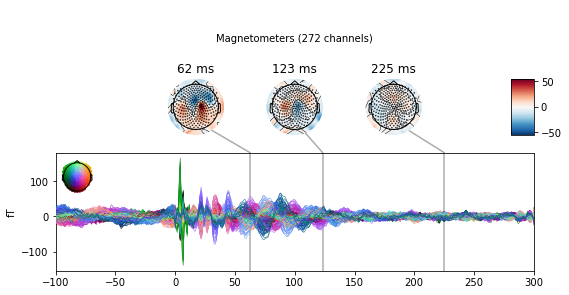

In [25]:
diff = mne.combine_evoked([bst_epo.average(), -bst_sim_data.average()], weights="equal")
diff.plot_joint();

# Problems with the approach!
### The spectral information is lost!

SPM face data PSD


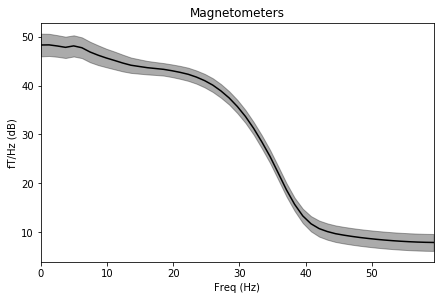

SPM face simulate PSD


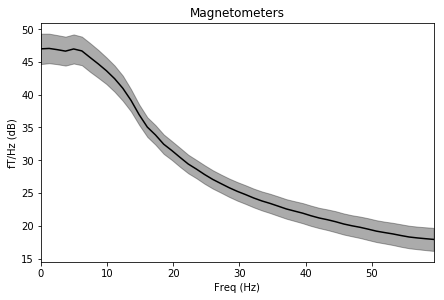

In [26]:
print("SPM face data PSD")
spm_epo.plot_psd(fmax=60);
print("SPM face simulate PSD")
spm_sim_data.plot_psd(fmax=60);

Somato data PSD


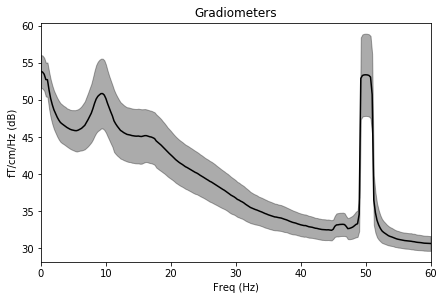

Somato simulate PSD


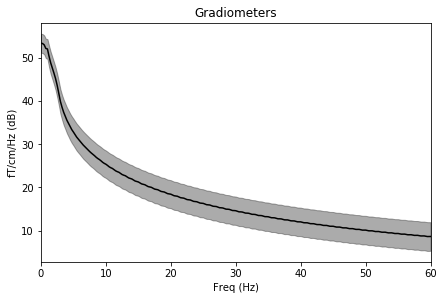

In [27]:
print("Somato data PSD")
somato_epo.plot_psd(fmax=60);
print("Somato simulate PSD")
somato_sim_data.plot_psd(fmax=60);

## possible solution fit polynomial to the power or envelope 

Preprocessing: 

* bandpass filtered
    * theta (4, 7)
    * alpha (8, 12)
    * beta (13, 25)
    * Gamma (30, 45)
* Hilbert transform
* For each band epochs were created and fitted by a higher order polynomial 

In [28]:
# Use real example data
data_path = somato.data_path()
raw_fname = data_path + '/MEG/somato/sef_raw_sss.fif'

# let's explore some frequency bands
iter_freqs = [
    ('Theta', 4, 7),
    ('Alpha', 8, 12),
    ('Beta', 13, 25),
    ("Gamma", 30, 45)
]

# set epoching parameters
event_id, tmin, tmax = 1, -0.5, 0.5
baseline = None

# get the header to extract events
raw = mne.io.read_raw_fif(raw_fname, preload=False)
events = mne.find_events(raw, stim_channel='STI 014')

frequency_map = list()

for band, fmin, fmax in iter_freqs:
    # (re)load the data to save memory
    raw = mne.io.read_raw_fif(raw_fname, preload=True)
    raw.pick_types(meg='grad', eog=True)  # we just look at gradiometers

    # bandpass filter and compute Hilbert
    raw.filter(fmin, fmax, n_jobs=1,  # use more jobs to speed up.
               l_trans_bandwidth=1,  # make sure filter params are the same
               h_trans_bandwidth=1,  # in each band and skip "auto" option.
               fir_design='firwin')
    raw.apply_hilbert(n_jobs=1, envelope=False)

    epochs = mne.Epochs(raw, events, event_id, tmin, tmax, baseline=baseline,
                        reject=dict(grad=4000e-13, eog=350e-6), preload=True)
    # remove evoked response and get analytic signal (envelope)
    epochs.subtract_evoked()  # for this we need to construct new epochs.
    epochs = mne.EpochsArray(
        data=np.abs(epochs.get_data()), info=epochs.info, tmin=epochs.tmin)
    # now average and move on
    frequency_map.append(((band, fmin, fmax), epochs))

Opening raw data file /Users/au194693/mne_data/MNE-somato-data/MEG/somato/sef_raw_sss.fif...
    Range : 237600 ... 506999 =    791.189 ...  1688.266 secs
Ready.
Current compensation grade : 0
111 events found
Events id: [1]
Opening raw data file /Users/au194693/mne_data/MNE-somato-data/MEG/somato/sef_raw_sss.fif...
    Range : 237600 ... 506999 =    791.189 ...  1688.266 secs
Ready.
Current compensation grade : 0
Reading 0 ... 269399  =      0.000 ...   897.077 secs...
Setting up band-pass filter from 4 - 7 Hz
Filter length of 991 samples (3.300 sec) selected
111 matching events found
0 projection items activated
Loading data for 111 events and 301 original time points ...
    Rejecting  epoch based on EOG : ['EOG 061']
1 bad epochs dropped
Subtracting Evoked from Epochs
    The following channels are not included in the subtraction: EOG 061
[done]
110 matching events found
0 projection items activated
0 bad epochs dropped
Opening raw data file /Users/au194693/mne_data/MNE-somato-data

In [29]:
beta_data = frequency_map[2][1]
beta_sim = sd.make_sim_data(beta_data, order=17)
alpha_data = frequency_map[1][1]
alpha_sim = sd.make_sim_data(alpha_data, order=17)
theta_data = frequency_map[0][1]
theta_sim = sd.make_sim_data(theta_data, order=17)
gamma_data = frequency_map[3][1]
gamma_sim = sd.make_sim_data(theta_data, order=17)

110 matching events found
0 projection items activated
0 bad epochs dropped
110 matching events found
0 projection items activated
0 bad epochs dropped
110 matching events found
0 projection items activated
0 bad epochs dropped
110 matching events found
0 projection items activated
0 bad epochs dropped


### Theta

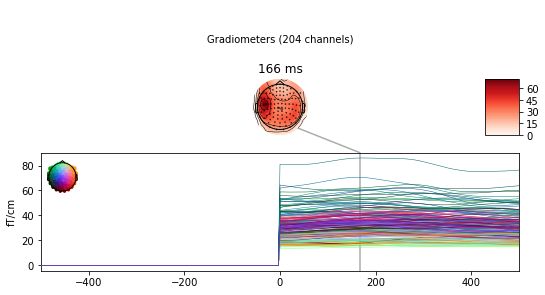

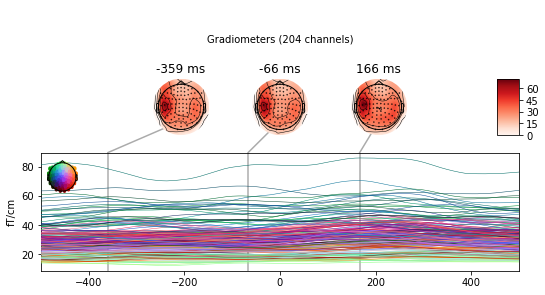

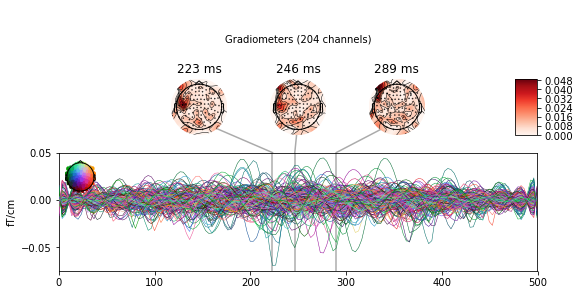

In [34]:
theta_sim.average().plot_joint();
theta_data.average().plot_joint();
theta_diff = mne.combine_evoked([theta_data.average(), -theta_sim.average()],
                                 weights="equal")
theta_diff.copy().crop(0, None).plot_joint();

### Alpha

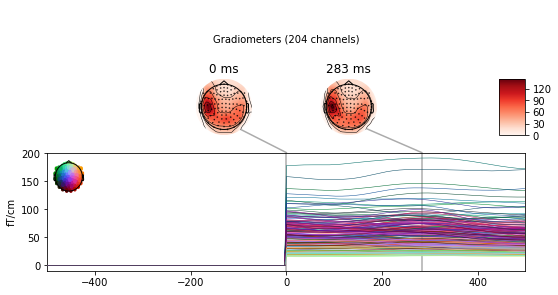

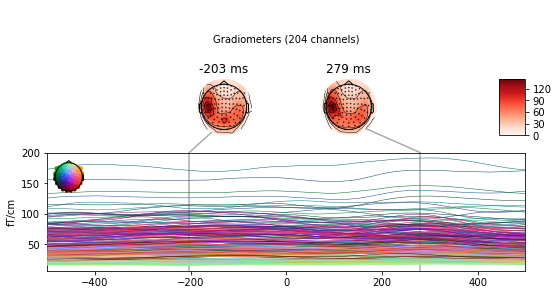

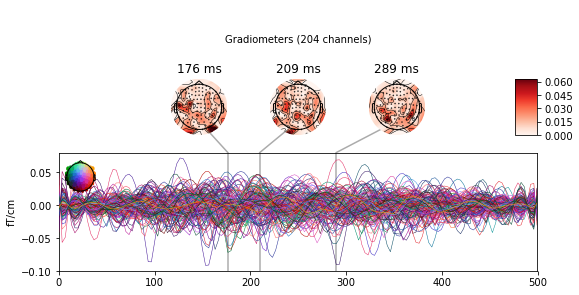

In [31]:
alpha_sim.average().plot_joint();
alpha_data.average().plot_joint();
alpha_diff = mne.combine_evoked([alpha_data.average(), -alpha_sim.average()],
                                weights="equal")
alpha_diff.copy().crop(0, None).plot_joint();

### Beta

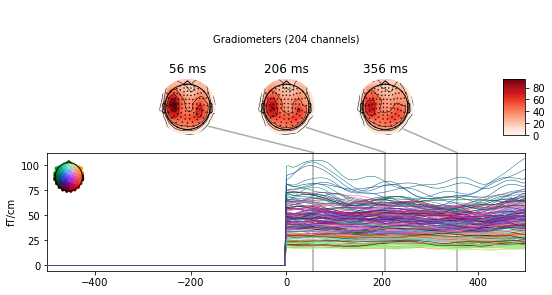

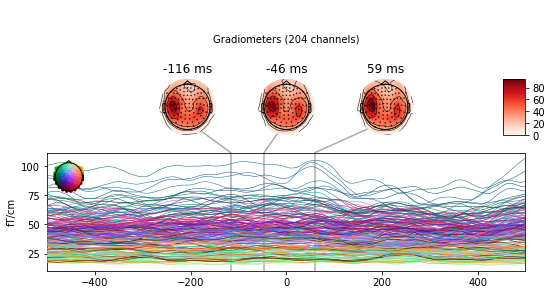

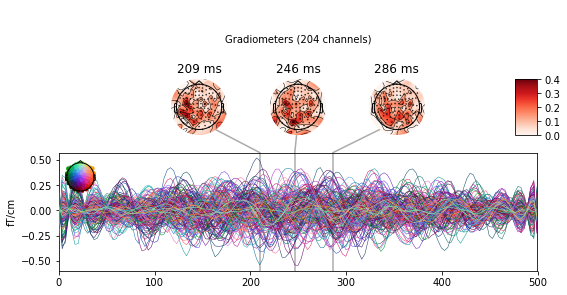

In [32]:
beta_sim.average().plot_joint();
beta_data.average().plot_joint();
beta_diff = mne.combine_evoked([beta_data.average(), -beta_sim.average()],
                               weights="equal")
beta_diff.copy().crop(0, None).plot_joint();

### Gamma (low)

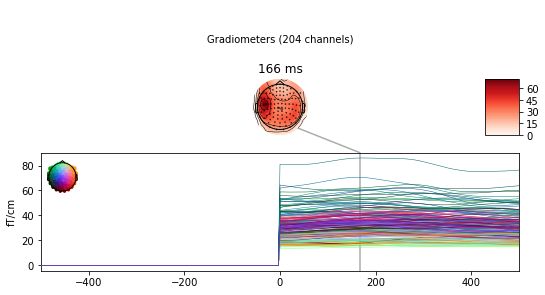

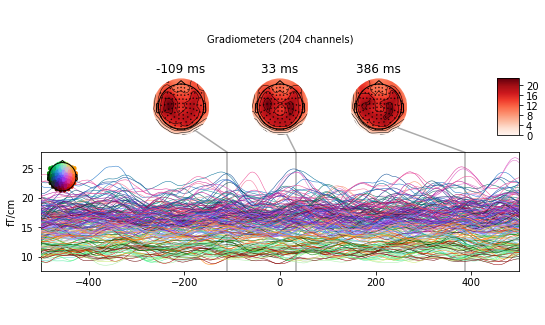

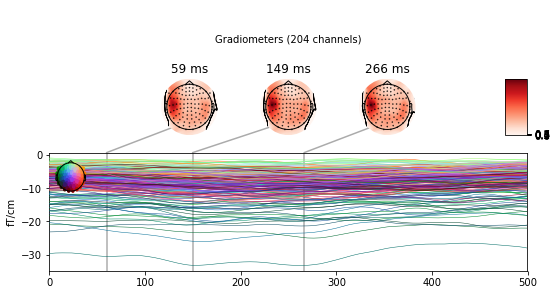

In [33]:
gamma_sim.average().plot_joint();
gamma_data.average().plot_joint();
gamma_diff = mne.combine_evoked([gamma_data.average(), -gamma_sim.average()],
                                weights="equal")
gamma_diff.copy().crop(0, None).plot_joint();